##1. CODE TO PERFORM ROTATION, TRANSLATION AND RESIZING


Photo Credit: https://www.flickr.com/photos/smoothgroover22/15104006386


# LOAD/DISPLAY IMAGE

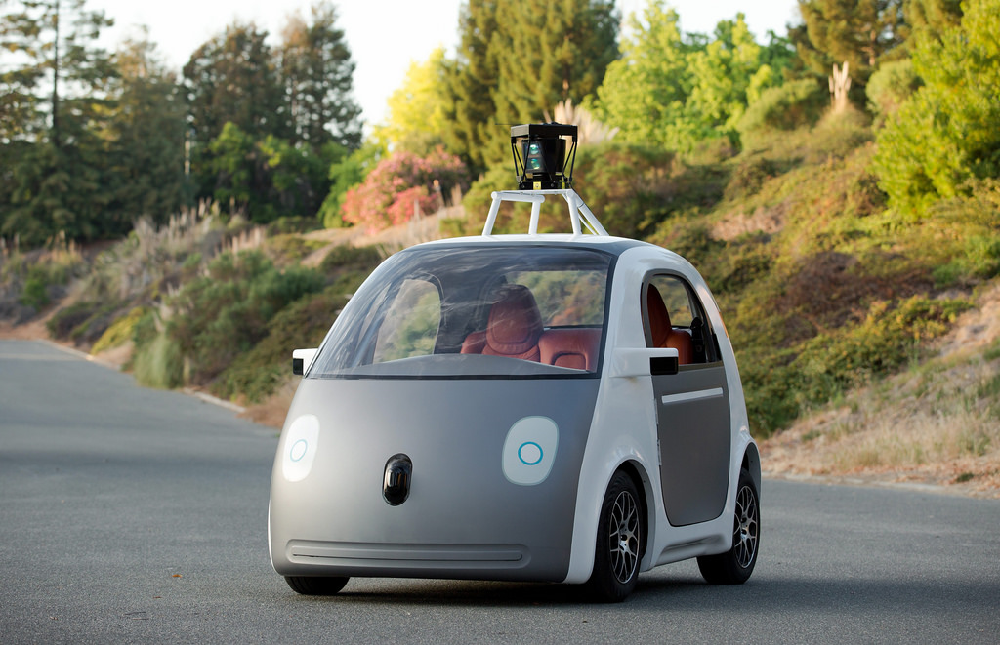

In [ ]:
import cv2
import numpy as np
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
%matplotlib inline

image = cv2.imread('Self_Driving_Car.jpg')
cv2_imshow(image)
cv2.waitKey()
cv2.destroyAllWindows()


In [ ]:
height, width = image.shape[:2]

In [ ]:
height

661

In [ ]:
width

1024

# PERFORM ROTATIONS

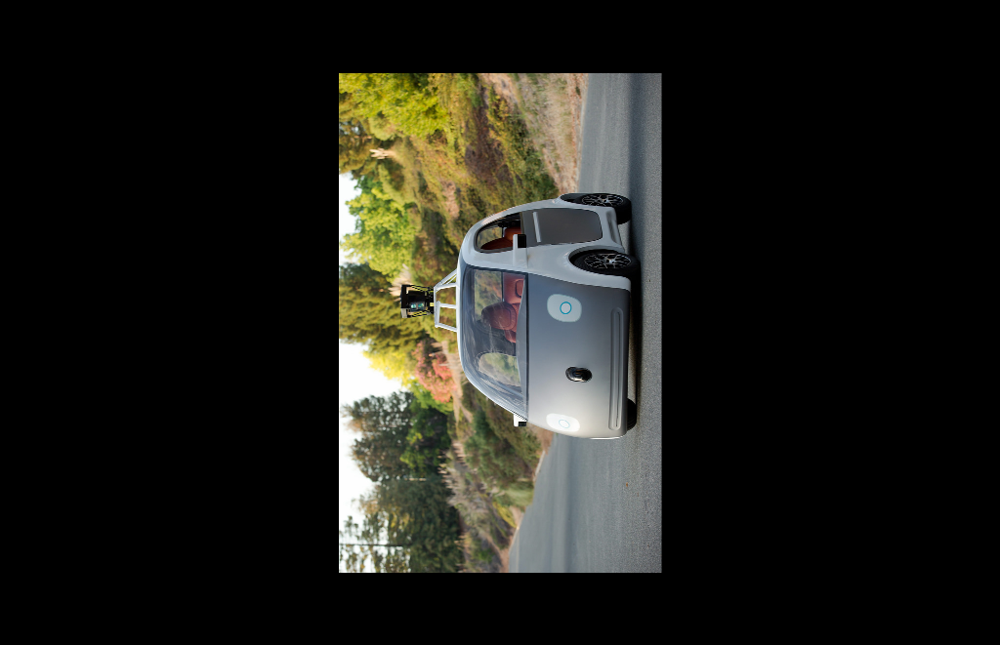

In [ ]:
M_rotation = cv2.getRotationMatrix2D((width/2, height/2), 90, 0.5) # Rotate around the center
rotated_image = cv2.warpAffine(image, M_rotation, (width, height)) # insert size of the output image

cv2_imshow(rotated_image)
cv2.waitKey()
cv2.destroyAllWindows()

# PERFORM TRANSLATIONS

In [ ]:
Translational_Matrix = np.float32([[1, 0, 300],
                                  [0, 1, 50]])

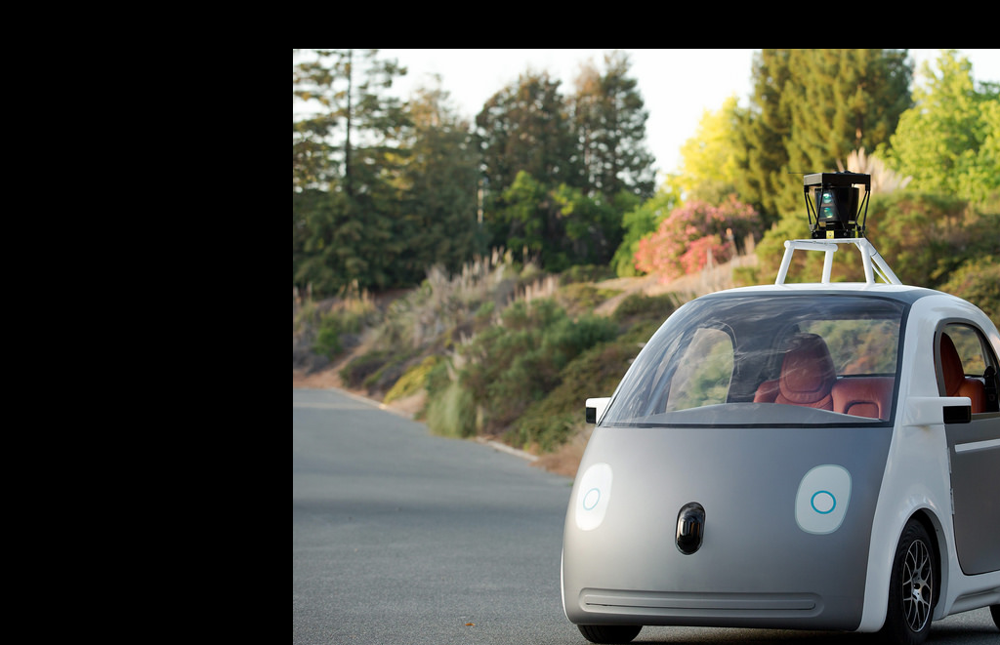

In [ ]:
translated_image = cv2.warpAffine(image, Translational_Matrix, (width, height))
cv2_imshow(translated_image)
cv2.waitKey()
cv2.destroyAllWindows()

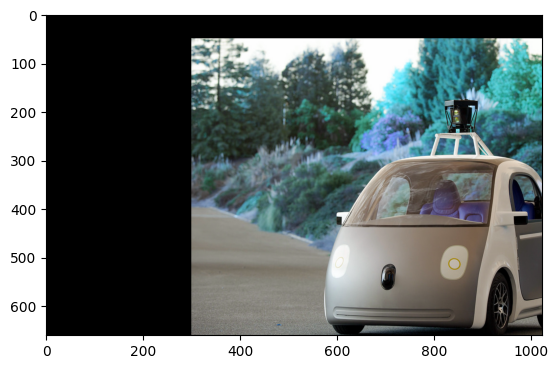

In [ ]:
# Don't worry about the color, recall openCV uses BGR instead of RGB
plt.imshow(translated_image)

# PERFORM RESIZING

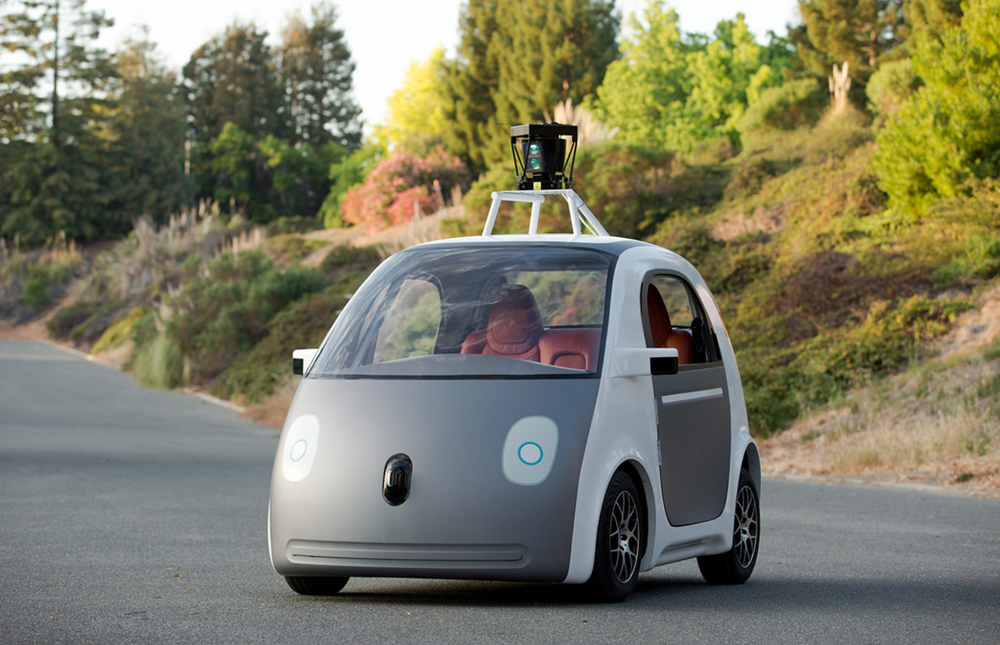

In [ ]:
resized_image = cv2.resize(image, None, fx=4, fy=4, interpolation = cv2.INTER_CUBIC) # Try 0.5
cv2_imshow(resized_image)
cv2.waitKey()
cv2.destroyAllWindows()

# 2. CODE TO PERFORM PERSPECTIVE TRANSFORM

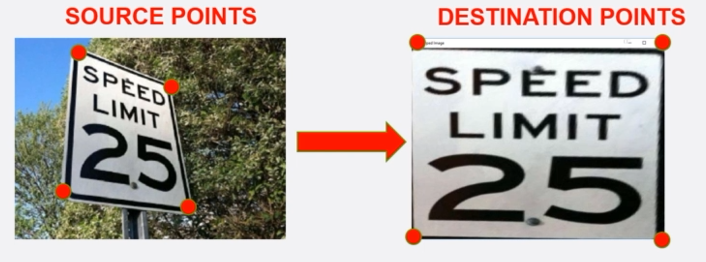

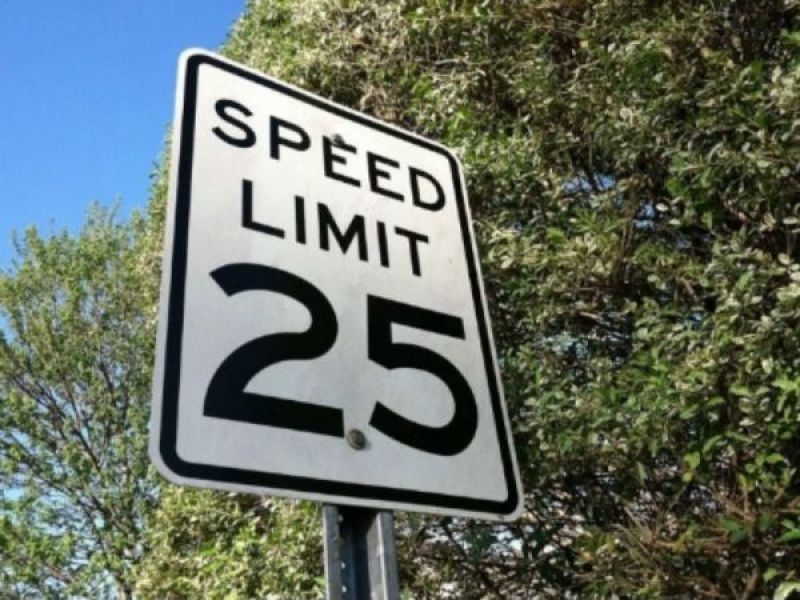

In [ ]:
import cv2
import numpy as np
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
%matplotlib inline

image = cv2.imread('Speed_Sign_View_2.jpg')
cv2_imshow(image)
cv2.waitKey()
cv2.destroyAllWindows()

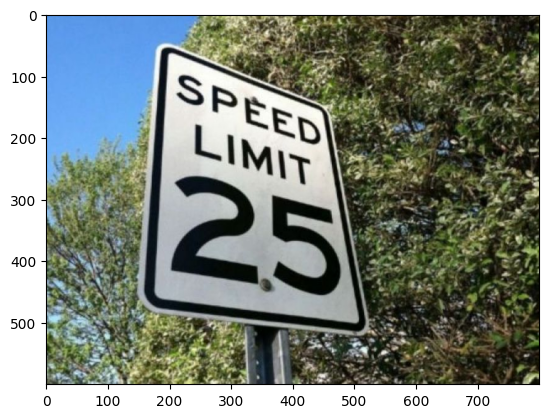

In [ ]:
image = mpimg.imread('Speed_Sign_View_2.jpg')
plt.imshow(image)

In [ ]:
height, width = image.shape[:2]


In [ ]:
height

600

In [ ]:
width

800

In [ ]:
# First entry: top-left,
# Second entry: top-right
# Third: bottom-right
# Fourth: bottom-left

# Cordinates of the 4 corners of the original image
Source_points = np.float32([[200,60], [450,150], [520, 500], [170,470] ])

# Cordinates of the 4 corners of the desired output
Destination_points = np.float32([[0,0], [width,0], [width,height], [0,height]])

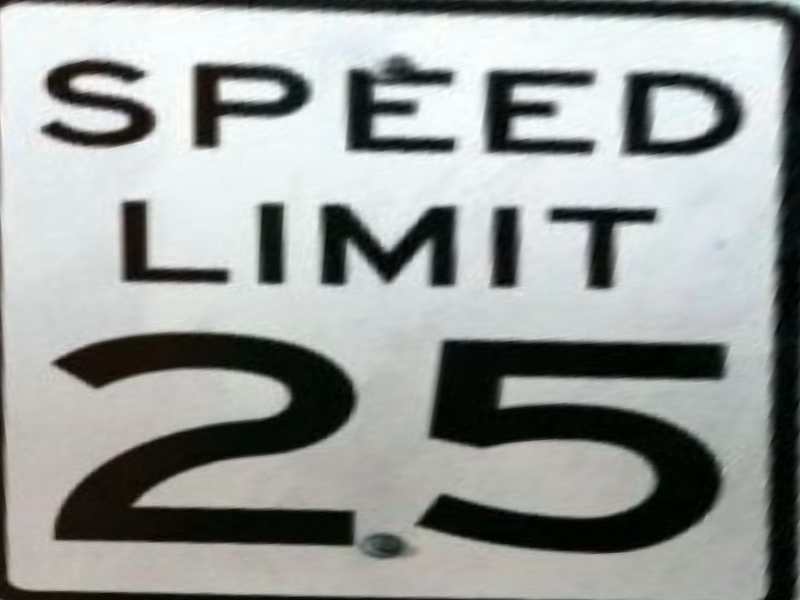

In [ ]:
# Use the two sets of four points to compute
# the Perspective Transformation matrix, M
M = cv2.getPerspectiveTransform(Source_points, Destination_points)

warped = cv2.warpPerspective(image, M, (width, height))

cv2_imshow(warped)
cv2.waitKey()
cv2.destroyAllWindows()

#3. CODE TO PERFORM CROPPING, DILATION AND EROSION

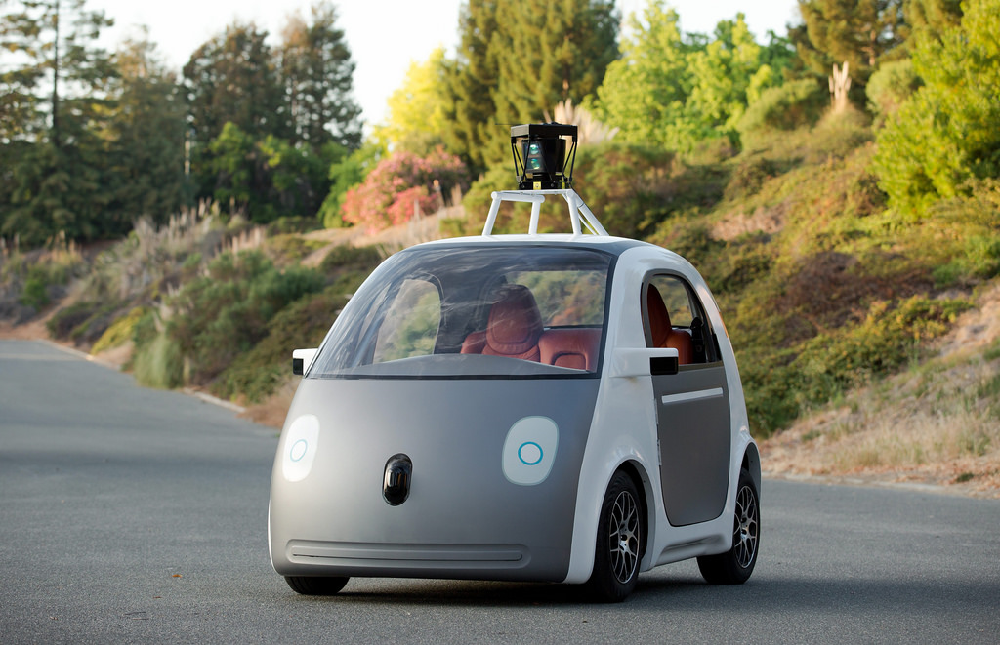

In [ ]:
import cv2
import numpy as np
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
%matplotlib inline

image = cv2.imread('Self_Driving_Car.jpg')
# image = mpimg.imread('Future_SelfDriving.jpg') # import image as RGB instead of BGR

cv2_imshow(image)
cv2.waitKey()
cv2.destroyAllWindows()

In [ ]:
height, width = image.shape[:2]

In [ ]:
height

661

In [ ]:
width

1024

PERFORM CROPPING

In [ ]:
# Top left coordinates of the desired cropped area (w0, h0)
w0 = int(width * 0.5)
h0 = int(height * 0.5)

In [ ]:
# Bottom right coordinates of the desired cropped area (w1, h1)
h1 = int(height * 1)
w1 = int(width * 1)


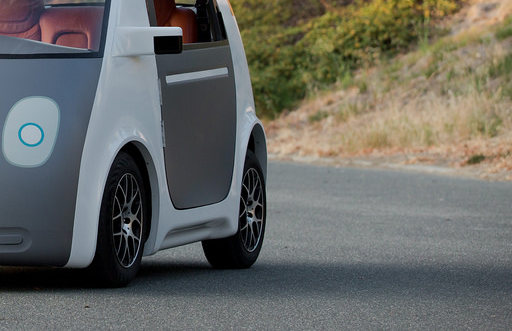

In [ ]:
Image_cropped = image[h0:h1 , w0:w1]

cv2_imshow(Image_cropped)
cv2.waitKey()
cv2.destroyAllWindows()

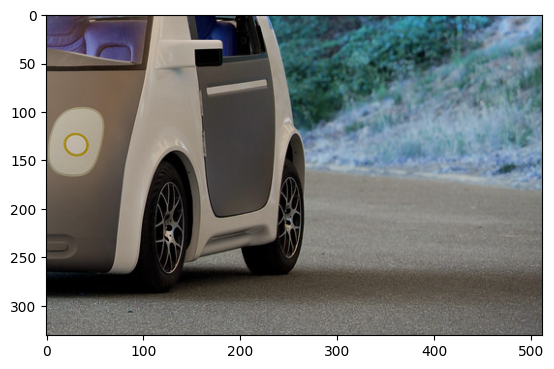

In [ ]:
# If you want to see the actual distance translated
# Don't worry about the color, recall openCV uses BGR instead of RGB
plt.imshow(Image_cropped)

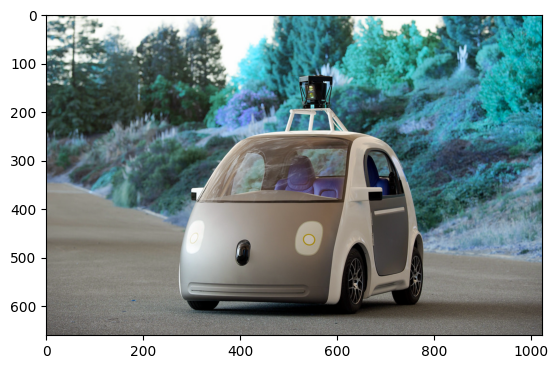

In [ ]:
plt.imshow(image)

PERFORM DILATION AND EROSION OPERATIONS

In [ ]:
image = cv2.imread('Speed_Sign_View_2.jpg')

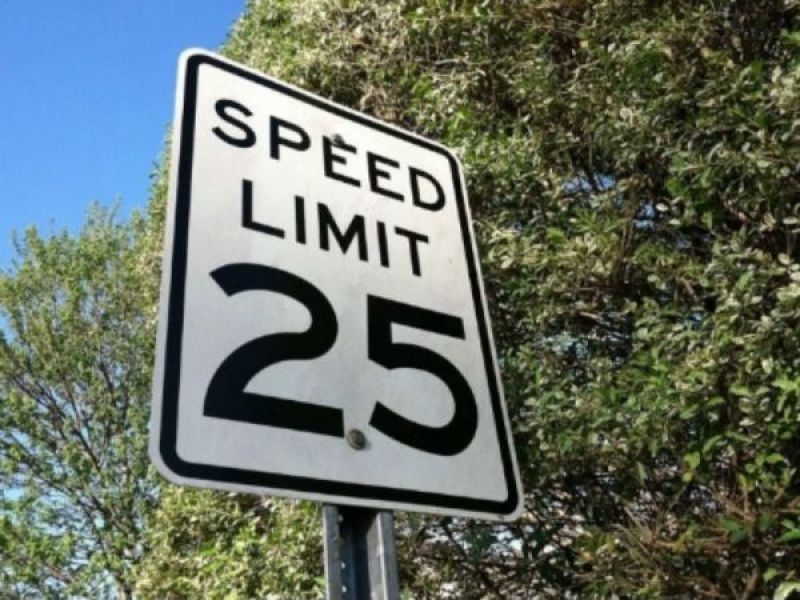

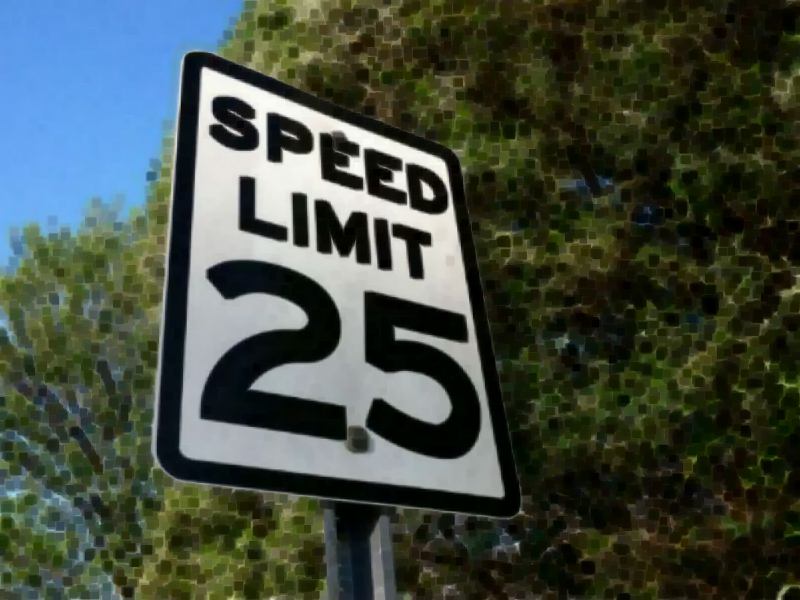

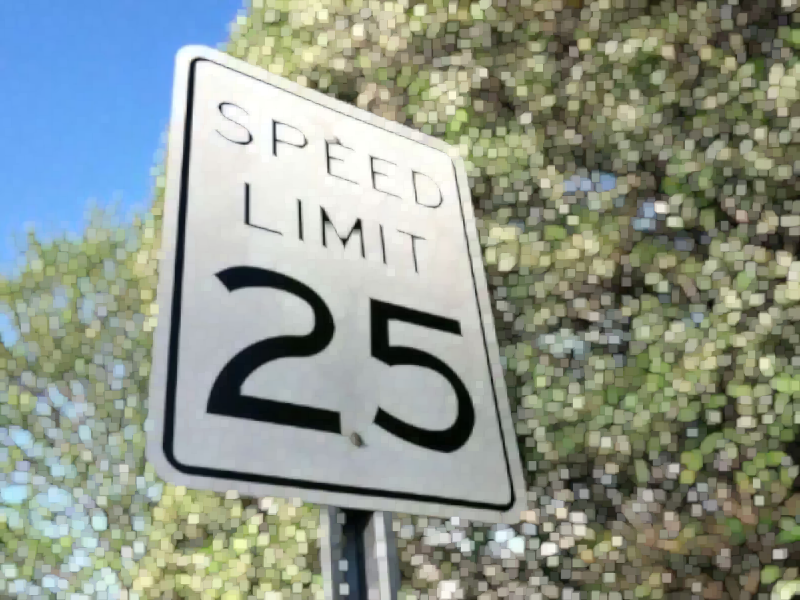

In [ ]:
kernel = np.ones((3,3), np.uint8)

image_erosion = cv2.erode(image, kernel, iterations=3) # Try several iterations
image_dilation = cv2.dilate(image, kernel, iterations=3)

cv2_imshow(image)
cv2_imshow(image_erosion)
cv2_imshow(image_dilation)

cv2.waitKey()
cv2.destroyAllWindows()

#4. CODE TO PERFORM REGION OF INTEREST (ROI) SELECTION

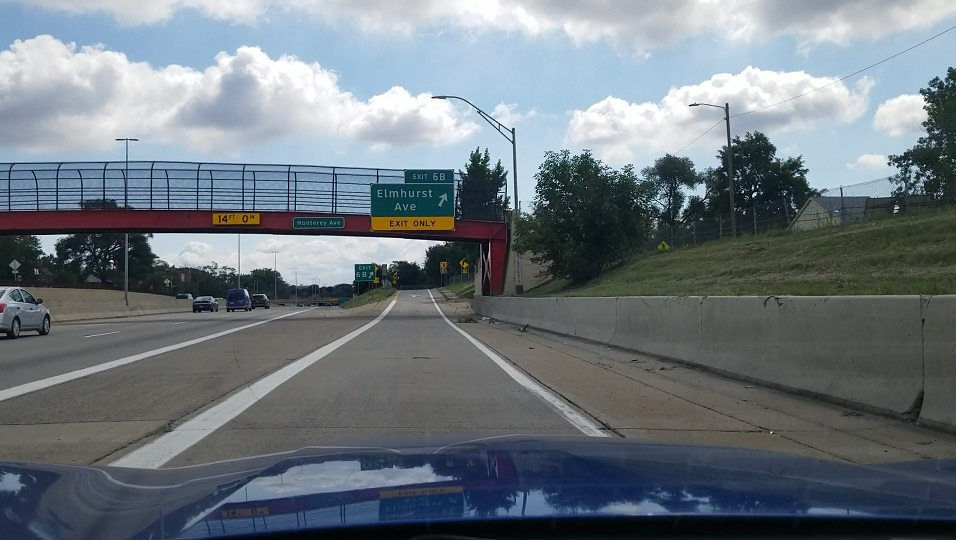

In [ ]:
import cv2
import numpy as np
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
%matplotlib inline

image_color = cv2.imread('new_test_image_3.jpg')
# image_color = mpimg.imread('image_lane_c.jpg') # import image as RGB instead of BGR

cv2_imshow( image_color)
cv2.waitKey()
cv2.destroyAllWindows()

In [ ]:
height, width = image_color.shape[:2]

In [ ]:
height

540

In [ ]:
width

956

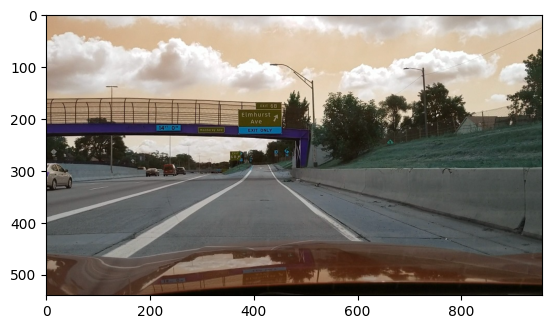

In [ ]:
plt.imshow(image_color)

colour slightly changed because we have changed it into CV2 which converts RBG into BGR

In [ ]:
image_color.shape

(540, 956, 3)

CONVERT TO GREYSCALE

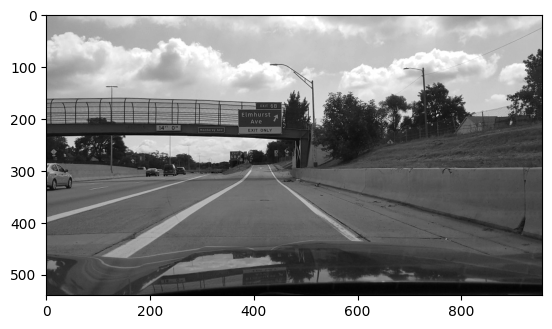

In [ ]:
image_gray = cv2.cvtColor(image_color, cv2.COLOR_BGR2GRAY)
plt.imshow(image_gray, cmap = 'gray')

In [ ]:
image_gray.shape

(540, 956)

PERFORM REGION OF INTEREST MASKING

In [ ]:
# Select points of the region of interest (ROI)
ROI = np.array([[(0, height),(320, 300), (500, 300), (width, height)]], dtype=np.int32)

# define a blank image with all zeros (ie: black)
blank = np.zeros_like(image_gray)

In [ ]:
blank.shape

(540, 956)

In [ ]:
# Fill the Region of interest with white color (ie: 255)!
mask = cv2.fillPoly(blank, ROI, 255)

# Perform bitwise AND operation to select only the region of interest
masked_image = cv2.bitwise_and(image_gray, mask)

In [ ]:
masked_image.shape

(540, 956)

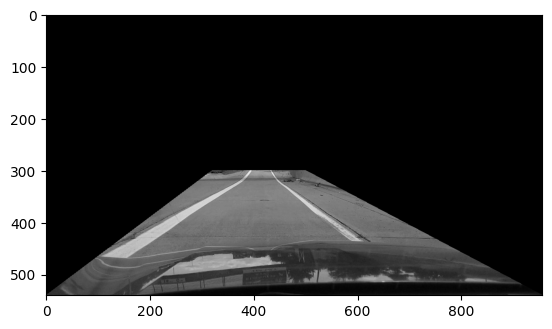

In [ ]:
plt.imshow(masked_image, cmap = 'gray')

# 5. CODE TO DETECT LINES IN IMAGE

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

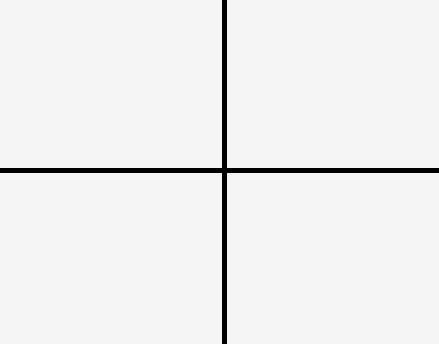

In [ ]:
image_c = cv2.imread('horizontal_vertical.jpg')
# image_c = cv2.imread('calendar.jpg')

cv2_imshow(image_c)
cv2.waitKey(0)
cv2.destroyAllWindows()

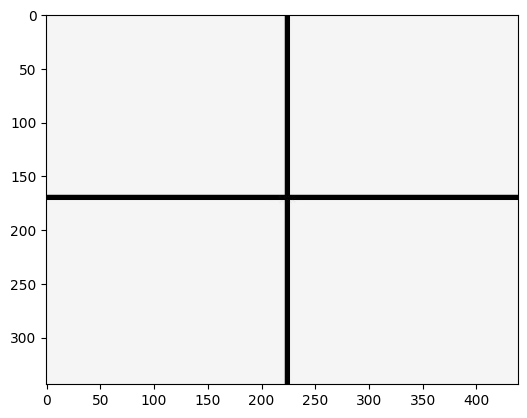

In [ ]:
plt.imshow(image_c)

In [ ]:
image_g = cv2.cvtColor(image_c, cv2.COLOR_BGR2GRAY)
image_canny = cv2.Canny(image_g, 50, 200, apertureSize = 3)
image_canny

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

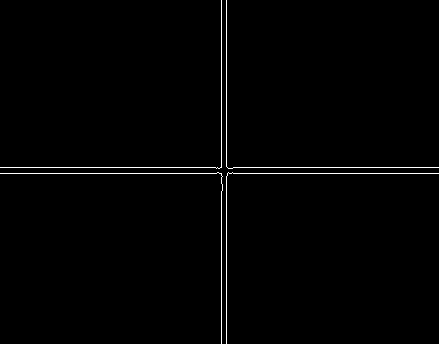

In [ ]:
cv2_imshow(image_canny)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
# rho accuracy of 1 pixel and theta accuracy of np.pi / 180 (1 degree)
# threshold is number of points on line
# Try 300, 400 and 500
lines = cv2.HoughLines(image_canny, 1, np.pi/180, 300)

In [ ]:
lines
# Note that 1.57 rad is 89.95437
# Note that rho was the distance from the origin

array([[[173.       ,   1.5707964]],

       [[167.       ,   1.5707964]],

       [[226.       ,   0.       ]],

       [[221.       ,   0.       ]]], dtype=float32)

In [ ]:
len(lines)

4

In [ ]:
lines.shape

(4, 1, 2)

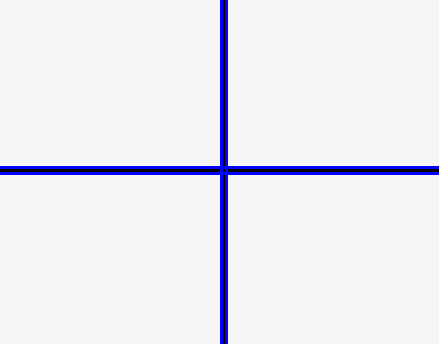

In [ ]:
 if lines is not None:
        for i in range(0, len(lines)):
            rho = lines[i][0][0]
            theta = lines[i][0][1]

            x0 = rho * np.cos(theta)
            y0 = rho * np.sin(theta)

            a = np.cos(theta)
            b = np.sin(theta)

            x1 = int(x0 + 1000 * (-b))
            y1 = int(y0 + 1000 * (a))
            x2 = int(x0 - 1000 * (-b))
            y2 = int(y0 - 1000 * (a))
            cv2.line(image_c, (x1, y1), (x2, y2), (255, 0, 0), 2)

cv2_imshow(image_c)
cv2.waitKey(0)
cv2.destroyAllWindows()

# 6. Detecting Lane Lines Project

CODE TO DETECT LANE LINES IN AN IMAGE

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import matplotlib.image as mpimg

READ AND SHOW THE IMAGE

(540, 956, 3)

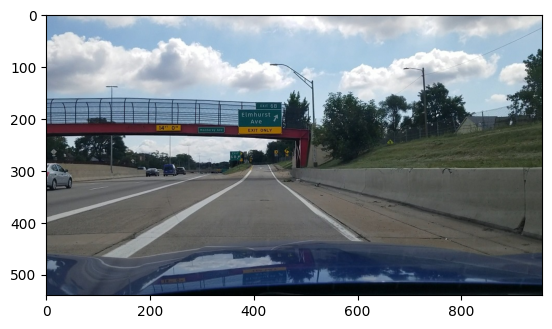

In [3]:
image_c = mpimg.imread('new_test_image_3.jpg')
plt.imshow(image_c)
image_c.shape

CONVERT TO GRAY SCALE

(540, 956)

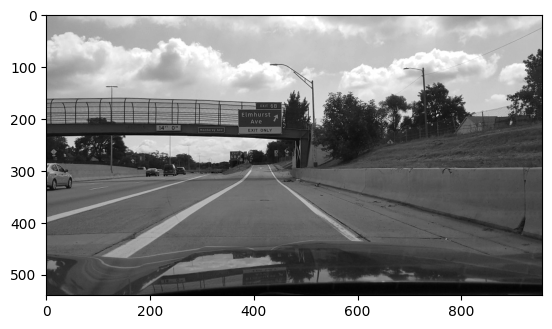

In [4]:
image_g = cv2.cvtColor(image_c, cv2.COLOR_RGB2GRAY)
plt.imshow(image_g, cmap = 'gray')
image_g.shape

GAUSSIAN BLURRING

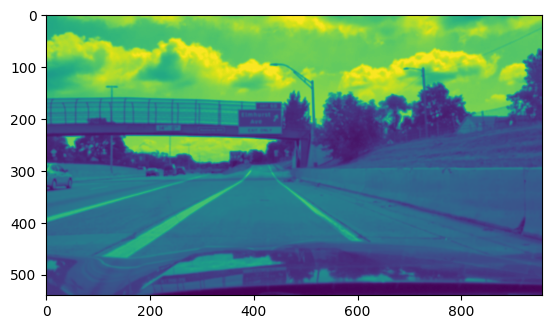

In [5]:
image_blurred = cv2.GaussianBlur(image_g, (7, 7), 0)
plt.imshow(image_blurred)

Canny

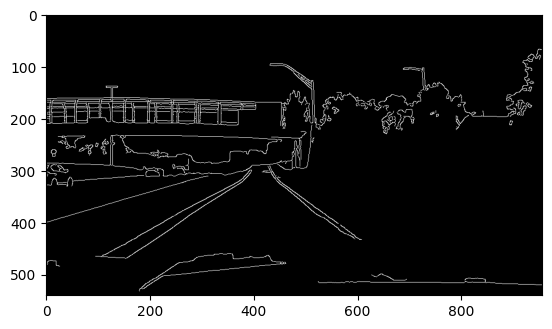

In [6]:
threshold_low = 10
threshold_high = 200

image_canny = cv2.Canny(image_blurred, threshold_low, threshold_high)
plt.imshow(image_canny, cmap = 'gray')

DEFINE THE REGION OF INTEREST

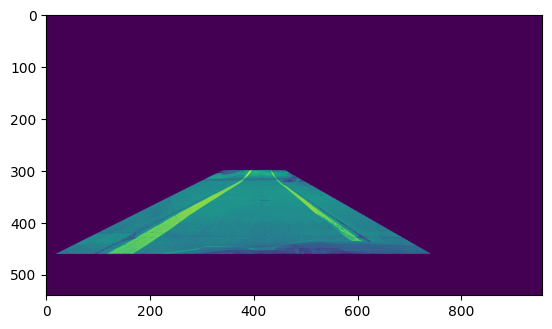

In [7]:
# Visualize the region of interest
vertices = np.array([[(20,460),(340, 300), (460, 300), (740,460)]], dtype=np.int32)
mask = np.zeros_like(image_g)
cv2.fillPoly(mask, vertices, 255)
masked_image = cv2.bitwise_and(image_g, mask)
plt.figure()
plt.imshow(masked_image)

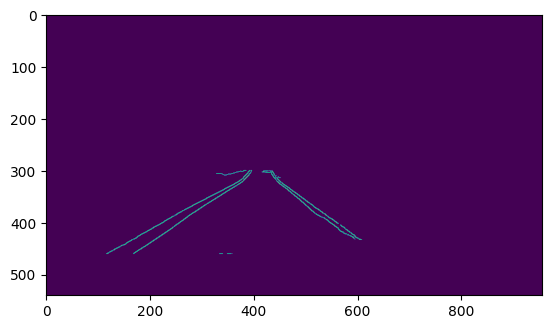

In [8]:
masked_image = cv2.bitwise_and(image_canny, mask)
plt.figure()
plt.imshow(masked_image)

HOUGH LINES DETECTION AND DRAW FUNCTION

In [9]:
rho = 2            # distance resolution in pixels
theta = np.pi/180  # angular resolution in radians
threshold = 40     # minimum number of votes
min_line_len = 100  # minimum number of pixels making up a line
max_line_gap = 50  # maximum gap in pixels between connectable line segments
lines = cv2.HoughLinesP(masked_image, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)

# Create an empty black image
line_image = np.zeros((masked_image.shape[0], masked_image.shape[1], 3), dtype=np.uint8)

for line in lines:
    for x1,y1,x2,y2 in line:
        cv2.line(line_image, (x1, y1), (x2, y2), [255, 0, 0], 20)
lines

array([[[120, 459, 263, 377]],

       [[168, 460, 389, 311]],

       [[419, 301, 607, 433]],

       [[255, 382, 382, 317]],

       [[118, 460, 226, 400]],

       [[116, 460, 311, 352]]], dtype=int32)

In [10]:
α = 1
β = 1
γ = 0

# Resultant weighted image is calculated as follows: original_img * α + img * β + γ
Image_with_lines = cv2.addWeighted(image_c, α, line_image, β, γ)

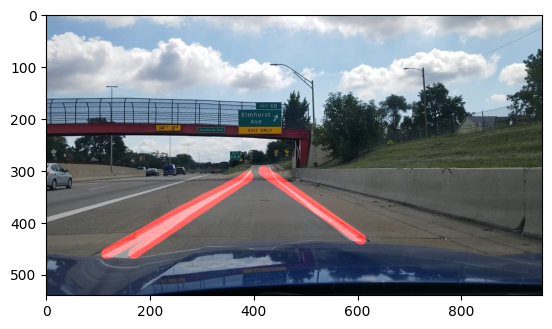

In [11]:
plt.figure()
plt.imshow(Image_with_lines)